In [3]:
%pylab inline

from pixell import utils, curvedsky, enplot, enmap
from actsims.signal import SignalGen

Populating the interactive namespace from numpy and matplotlib


/global/homes/y/yguan/.conda/envs/myenv/lib/python3.6/site-packages/IPython/core/magics/pylab.py:160: UserWarning: pylab import has clobbered these variables: ['seed']
`%matplotlib` prevents importing * from pylab and numpy
  "\n`%matplotlib` prevents importing * from pylab and numpy"


In [4]:
pixel_size = 0.5   # test
lmax = 8000        # test
seed = 1           # test
A_CB = 1.          # test

In [5]:
ell = np.arange(2, lmax)
ps_alpha = A_CB*1E-4*2*np.pi/(ell*(ell+1))

In [6]:
shape, wcs = enmap.fullsky_geometry(pixel_size * utils.arcmin)
alpha_map = curvedsky.rand_map((1,)+shape, wcs, ps_alpha, lmax=lmax, seed=seed)

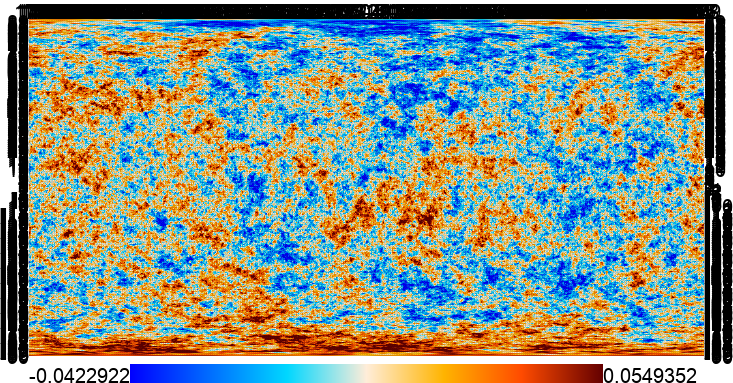

In [5]:
enplot.show(enplot.plot(alpha_map, downgrade=32, colorbar=True))

# before rotation

loading sims for s15_deep56_pa1_f150_set00_00000
loading alm base
loading /global/cscratch1/sd/engelen/simsS1516_v0.4/data/fullskyLensedCMB_alm_set00_00000.fits
adding fgs to the base
loading fg alm
(2, 2, 10001) (0, 0, 1, 0)
apply beam for alm s15_deep56_pa1_f150_set00_00000
Allocating shape (3, 1416, 43200) dtype d intermediate map
Performing alm2map
apply window


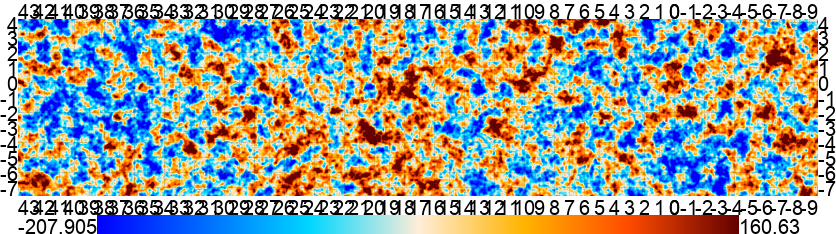

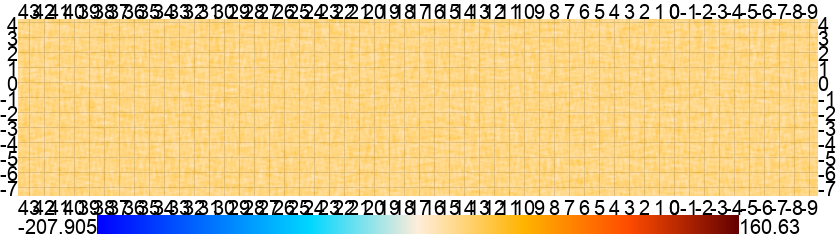

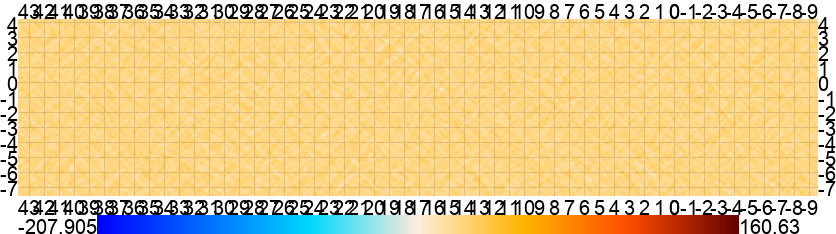

In [6]:
sg = SignalGen()
map_patch = sg.get_signal_sim("s15", "deep56", "pa1", "f150", 0, 0)
enplot.show(enplot.plot(map_patch, downgrade=8, colorbar=True))

# after rotation

loading sims for s15_deep56_pa1_f150_set00_00000
loading alm base
loading /global/cscratch1/sd/engelen/simsS1516_v0.4/data/fullskyLensedCMB_alm_set00_00000.fits
applying rotation field
adding fgs to the base
loading fg alm
(2, 2, 10001) (0, 0, 1, 0)
apply beam for alm s15_deep56_pa1_f150_set00_00000
Allocating shape (3, 1416, 43200) dtype d intermediate map
Performing alm2map
apply window


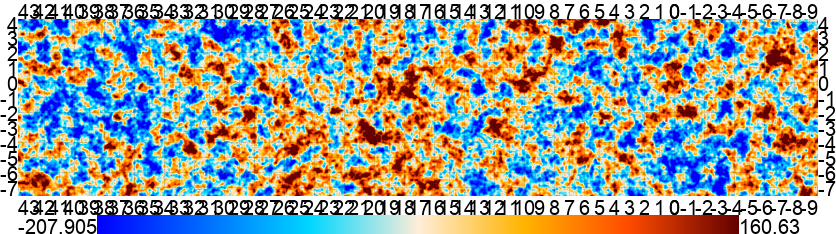

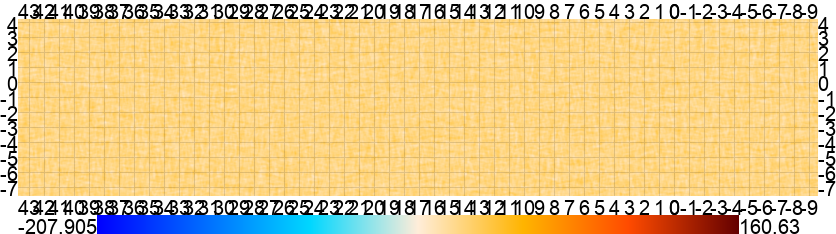

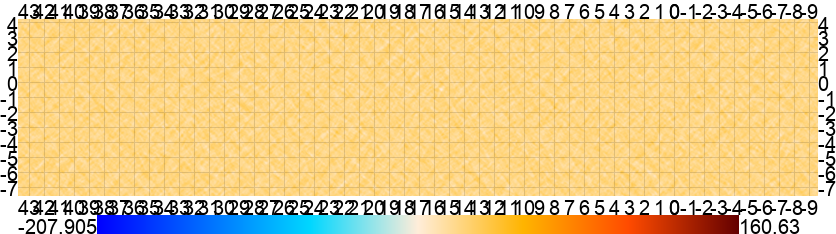

In [7]:
sg = SignalGen(apply_rotation=True, alpha_map=alpha_map)
map_patch = sg.get_signal_sim("s15", "deep56", "pa1", "f150", 0, 0)
enplot.show(enplot.plot(map_patch, downgrade=8, colorbar=True))

# with noise

In [20]:
from actsims import simgen

In [21]:
sg = simgen.SimGen("v5.3.0_mask_version_padded_v1", apply_rotation=True, alpha_map=alpha_map)

In [23]:
map_test = sg.get_sim("s15", "deep56", "pa3", sim_num=0)

/global/project/projectdirs/act/data/actsims_data/covsqrt//v5.3.0_mask_version_padded_v1/act_mr3_s15_deep56_pa3_coadd_est_True_covsqrt.fits (6, 6, 1820, 6825)


/global/u1/y/yguan/software/actsims/actsims/noise.py:221: RuntimeWarning: divide by zero encountered in true_divide
  isivars   = ((1./wmaps) - (1./wmaps.sum(axis=1)[:,None,...]))**0.5
/global/u1/y/yguan/software/actsims/actsims/noise.py:221: RuntimeWarning: invalid value encountered in subtract
  isivars   = ((1./wmaps) - (1./wmaps.sum(axis=1)[:,None,...]))**0.5


loading sims for s15_deep56_pa3_f090_set00_00000
loading alm base
loading /global/cscratch1/sd/engelen/simsS1516_v0.4/data/fullskyLensedCMB_alm_set00_00000.fits
applying rotation field
adding fgs to the base
loading fg alm
(2, 2, 10001) (0, 0, 1, 0)
apply beam for alm s15_deep56_pa3_f090_set00_00000
Allocating shape (3, 1820, 43200) dtype d intermediate map
Performing alm2map
apply window
loading sims for s15_deep56_pa3_f150_set00_00000
apply beam for alm s15_deep56_pa3_f150_set00_00000
purging s15_deep56_pa3_f090_set00_00000 from the cache
Allocating shape (3, 1820, 43200) dtype d intermediate map
Performing alm2map
apply window


In [24]:
map_test.shape

(2, 4, 3, 1820, 6825)

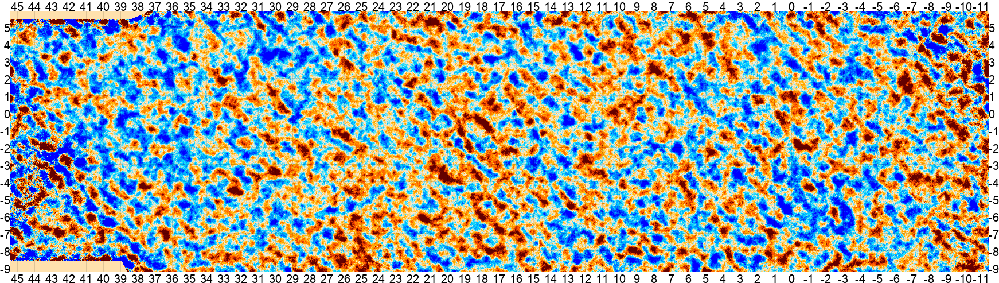

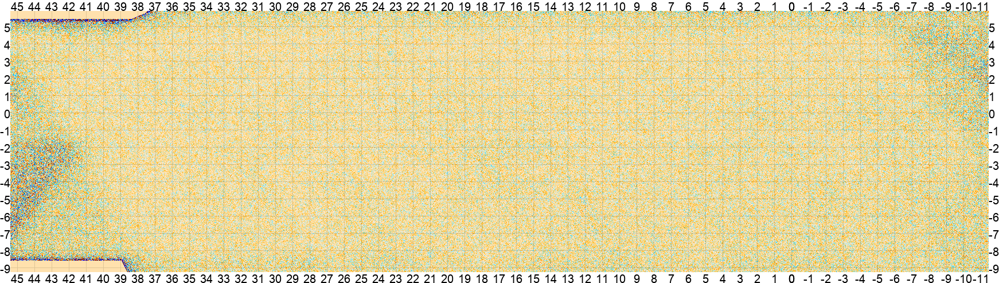

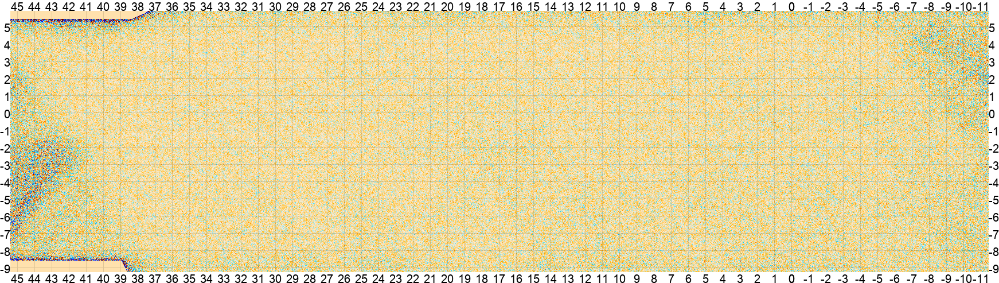

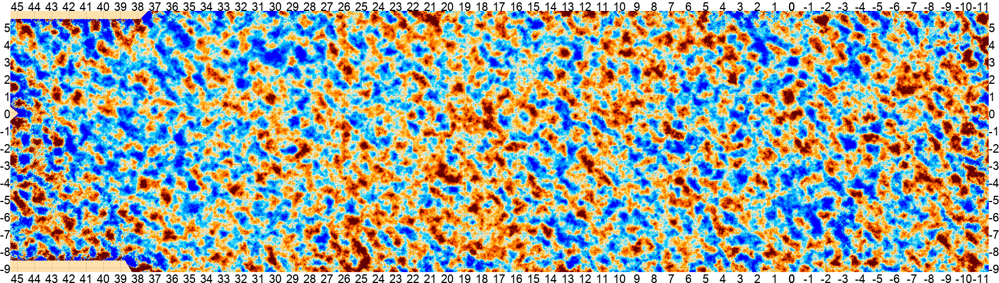

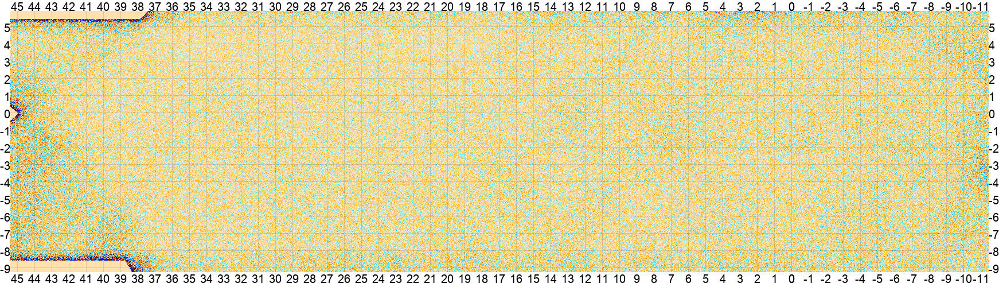

...

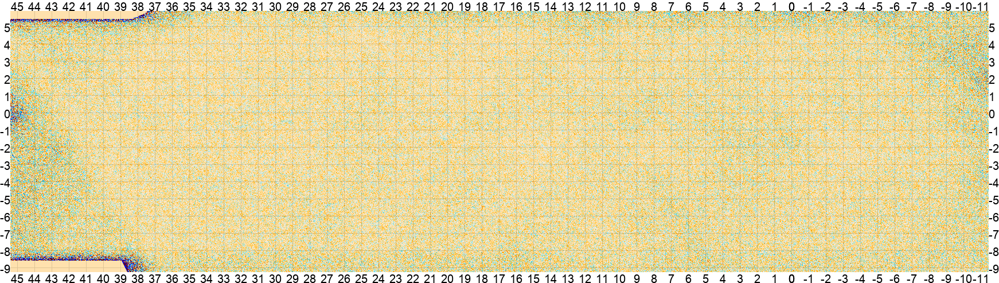

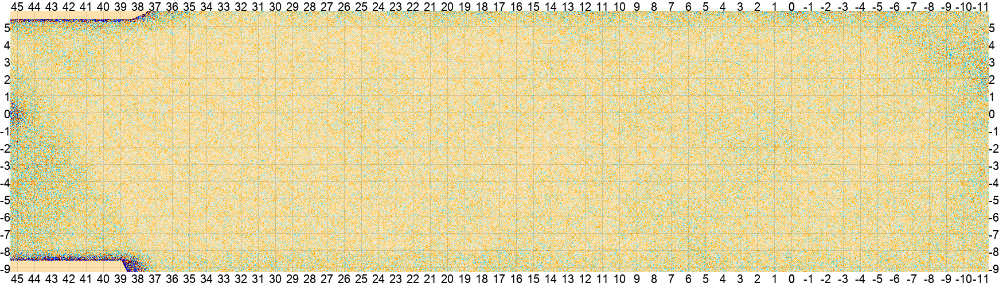

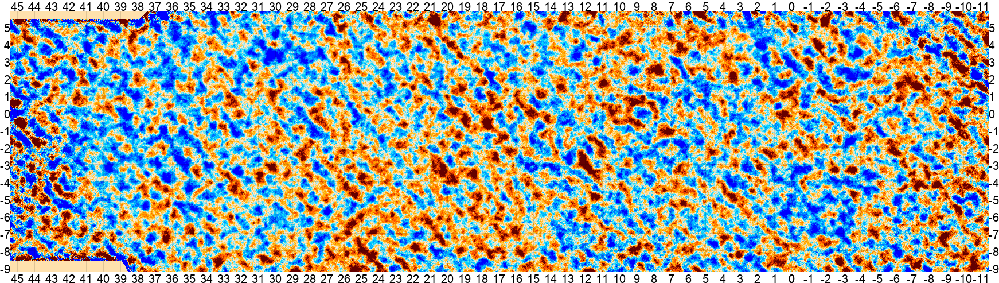

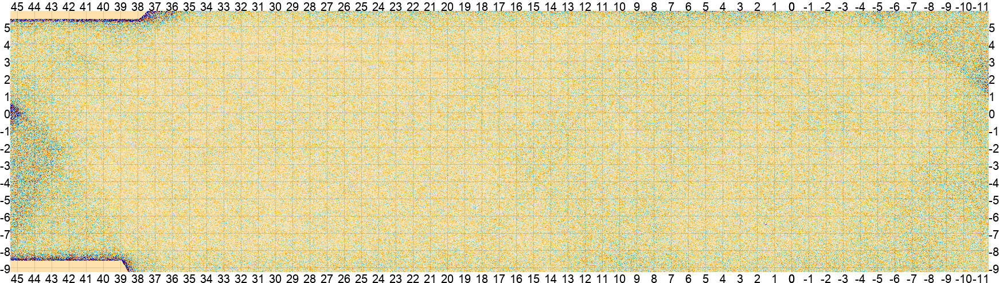

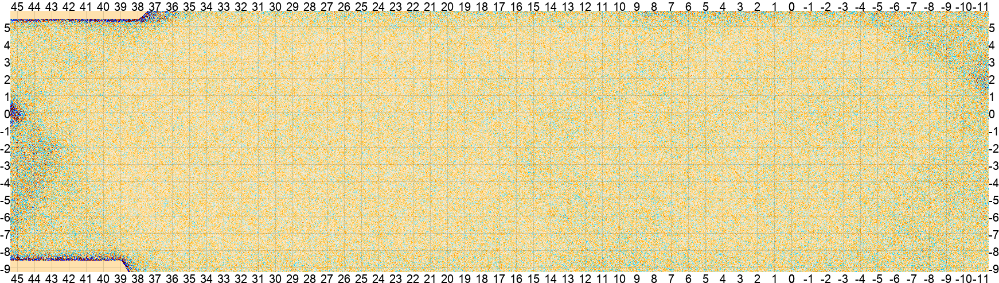

In [18]:
enplot.show(enplot.plot(map_test, downgrade=4))

In [19]:
map_test.shape

(1, 4, 3, 1820, 6825)